In [1]:
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import scipy.stats as scis 
from BayesOpt.BayesianOptimizer import BayesianOptimizer
from BayesOpt.GaussianProcess import GaussianProcess 
from BayesOpt.utils.plot import *

import plotly.graph_objs as go
import plotly.offline as pyo

from joblib import Parallel, delayed

%matplotlib inline
matplotlib.rcParams.update({
    "figure.figsize": (12, 4),
    "axes.spines.top": False,
    "axes.spines.right": False
})

np.random.seed(42)

# Bayesian Optimization for Hyperparameter Tuning

In this Notebook, we will explore Bayesian Optimization, a powerful technique for finding the optimal value of a complex function with a minimum number of function evaluations. We will build upon our understanding of Gaussian Processes to search for the optimum of a difficult-to-model function. In each iteration, we will optimize the hyperparameters of the Gaussian Process model after observing a function value (MLE). We will explore three acquisition functions: Upper Confidence Bound (UCB), Expected Improvement (EI), and Probability of Improvement (PI).


## 1. Introduction to Bayesian Optimization

Bayesian Optimization is a powerful and efficient technique for finding the optimal value of a complex and expensive-to-evaluate function with a minimum number of function evaluations. It is particularly useful for optimizing functions that have unknown smoothness, are noisy, or have high-dimensional input spaces.

One of the main applications of Bayesian Optimization is hyperparameter tuning in machine learning models, where the objective is to find the best hyperparameter configuration that maximizes the model's performance on a given task. Evaluating the performance of a model can be computationally expensive, making it crucial to minimize the number of evaluations while searching for the best configuration.

Bayesian Optimization leverages Gaussian Processes, which we studied in the previous notebook, to model the objective function. Gaussian Processes provide a non-parametric prior over functions, enabling the Bayesian Optimization algorithm to maintain a probabilistic representation of the objective function. This representation allows the algorithm to reason about the uncertainty in its predictions and to balance exploration (searching unexplored regions of the input space) and exploitation (focusing on regions with high predicted performance).

In this notebook, we will build upon our understanding of Gaussian Processes and delve into the Bayesian Optimization technique. We will implement the algorithm with three different acquisition functions – Upper Confidence Bound (UCB), Expected Improvement (EI), and Probability of Improvement (PI) – and compare their performance in optimizing a difficult-to-model function.



## 2. Objective Function

To demonstrate the Bayesian Optimization technique, we will define an objective function that we aim to optimize. The objective function represents the performance of a machine learning model as a function of its hyperparameters. In practice, this could be any metric such as accuracy, F1 score, or mean squared error, depending on the specific machine learning task.

For the purpose of this demonstration, we will use a synthetic objective function that mimics the behavior of a real-world function with certain characteristics, such as smoothness, local optima, and noise. This will allow us to focus on the optimization process without the computational overhead of training and evaluating actual machine learning models. We will use the [Branin-Hoo function](https://www.sfu.ca/~ssurjano/branin.html), which has the following form:
$$
f(\mathrm{x})=a\left(x_2-b x_1^2+c x_1-r\right)^2+s(1-t) \cos \left(x_1\right)+s
$$

In [2]:
TRUEMIN = 0.397887
def branin(x1, x2, a=1, b=5.1/(4*np.pi**2), c=5/np.pi, r=6, s=10, t=1/(8*np.pi)):
    return a*(x2 - b*x1**2 + c*x1 - r)**2 + s*(1 - t)*np.cos(x1) + s

box = np.array([[-5, 0], [10, 15]])
fig = plot_function(branin, box[0], box[1], 200, title="me", xlabel="this", ylabel="that")
fig


The chosen objective function has the following characteristics:

1. **Smoothness**: The function is smooth, which means that small changes in the input hyperparameters result in small changes in the output performance metric. This property is common in many machine learning models and allows us to use Gaussian Processes with smooth kernels like the RBF kernel.

2. **Local Optima**: The function has multiple local optima, which makes the optimization problem more challenging. Bayesian Optimization is well-suited for such problems, as it can balance exploration and exploitation to avoid getting trapped in local optima.

3. **Noise**: The function has no noise, but other applications could have. This would represent the variability in model performance due to factors such as random initializations or stochastic optimization algorithms. Bayesian Optimization can handle noisy functions by incorporating the noise into the Gaussian Process model.

Naturally, in BayesOpt applications we rarely have the function available to us - otherwise we would simply compute the minimum or take derivatives for gradient descent. Instead, assume we've explored some points. We will use Sobol sampling to create a fairly uniform distribution of early points.

In [3]:
def sobol_sample(num_draws, box):
    sampler = scis.qmc.Sobol(d=2, scramble=True)
    return box[0] + (box[1] - box[0]) * sampler.random(n=num_draws)

# Number of initial points, number of BO steps
n_init = 4

xinit = sobol_sample(n_init, box)
yinit = branin(xinit[:, 0], xinit[:, 1])

# create plotly with scatter xinit y init
scatter = go.Scatter3d(x=xinit[:, 0], y=xinit[:, 1], z=yinit, mode='markers', marker=dict(size=5, color=yinit, colorscale='Viridis', opacity=0.8))

scatterfig = go.Figure(data=[scatter])
scatterfig

These are draws from the Branin function, as shown in the plot below. 

In [4]:
fig = add_points(
    x=xinit[:, 0],
    y=xinit[:, 1],
    z=yinit,
    num_init=n_init,
    fig=fig
)
fig

Now that we have observed a few initial draws from the objective function, we can leverage Gaussian Processes to model the underlying, unknown function. Gaussian Processes provide a flexible, non-parametric approach for approximating functions with uncertain knowledge. By capturing the correlation between input points using a kernel function, a GP can express a wide range of functions and adapt to the observed data. As we gather more data points from the objective function, the Gaussian Process model will update its beliefs, refining its approximation of the true function and reducing uncertainty in regions where data has been observed. This ability to model the objective function and quantify uncertainty makes Gaussian Processes a suitable choice for the Bayesian Optimization algorithm, which uses this information to guide its search for the optimal hyperparameter configuration.

## 3. Gaussian Process Model

In this section, we will demonstrate how the Gaussian Process model can approximate the objective function given a few initial data points. Since we have already discussed Gaussian Processes in detail in the previous notebook, we will focus on illustrating how the GP model updates its beliefs as it observes more data points from the objective function.

In [5]:
bo = BayesianOptimizer(
    surrogate=GaussianProcess(), 
    initial_queries=xinit, 
    initial_observations=yinit,
    oracle=branin,
    box=box
)

After fitting the Gaussian Process model to the initial data points, we can visualize its approximation of the objective function. The shaded region in the plot represents the uncertainty of the GP model, which will decrease in regions where more data points are observed.

In [6]:
xspace = np.linspace(box[0][0], box[1][0], 25)
yspace = np.linspace(box[0][1], box[1][1], 25)
xx, yy = np.meshgrid(xspace, yspace)
Xcomb = np.vstack((xx.flatten(), yy.flatten())).T
outputs = Parallel(n_jobs=8)(delayed(bo.surrogate.predict)(i[np.newaxis, :]) for i in Xcomb)
ypreds, varpreds = np.array([i[0][0] for i in outputs]), np.array([i[1][0] for i in outputs])

surrogateplot = make_subplots(
    rows=1,
    cols=1,
    specs=[[{"type": "surface"}]],
)
out_df = pd.DataFrame(ypreds.reshape([xx.shape[0], yy.shape[1]]))
surrogateplot.add_trace(
    go.Surface(z=out_df, x=xx, y=yy, showscale=False, opacity=0.9, colorscale="geyser"),
    row=1,
    col=1,
)

surrogateplot = add_points(
    x=xinit[:, 0],
    y=xinit[:, 1],
    z=yinit,
    num_init=n_init,
    fig=surrogateplot
)
surrogateplot


As we can see, the Gaussian Process model provides a flexible and probabilistic representation of the objective function, which will be used by the Bayesian Optimization algorithm to guide its search for the optimal hyperparameter configuration. In the following sections, we will explore different acquisition functions and implement the Bayesian Optimization algorithm using the GP model.

Before diving into the acquisition functions, it is important to mention that during the Bayesian Optimization process, the hyperparameters of the Gaussian Process model will be updated regularly using marginal likelihoods. This allows the GP model to adapt to the observed data and improve its predictions as more samples are collected from the objective function. By maximizing the marginal likelihood of the data given the hyperparameters, we can obtain a more accurate and robust Gaussian Process model that is better suited for guiding the optimization process. With an updated GP model, the acquisition functions can make better-informed decisions about which points in the input space to explore or exploit, ultimately leading to a more efficient search for the optimal hyperparameter configuration.



## 4. Acquisition Functions

Acquisition functions play a crucial role in the Bayesian Optimization algorithm. They determine the balance between exploration and exploitation in the search for the optimal hyperparameter configuration. Exploration refers to sampling new regions of the input space to discover potentially better solutions, while exploitation involves focusing on regions where the predicted performance is already high. In this section, we will introduce three popular acquisition functions - Upper Confidence Bound (UCB), Expected Improvement (EI), and Probability of Improvement (PI) - and discuss their properties.

### Upper Confidence Bound (UCB)

The Upper Confidence Bound (UCB) acquisition function aims to balance exploration and exploitation by considering both the predicted performance and the uncertainty of the Gaussian Process model at each point in the input space. The UCB is defined as:

$$
UCB(x) = \mu(x) - \varepsilon \sigma(x)
$$

where $\mu(x)$ is the mean prediction, $\sigma(x)$ is the standard deviation, and $\varepsilon$ is a tunable exploration parameter. By adjusting the value of $\varepsilon$, we can control the balance between exploration and exploitation. A larger value of $\varepsilon$ encourages more exploration, while a smaller value focuses on exploitation.

* Advantages: UCB is easy to implement and provides a simple way to balance exploration and exploitation.
* Disadvantages: The choice of the exploration parameter $\varepsilon$ can have a significant impact on the performance of the algorithm, and it may require manual tuning or additional optimization.

### Expected Improvement (EI)

The Expected Improvement (EI) acquisition function measures the expected amount by which a new sample would improve upon the current best observed value. The EI is defined as:

$$
EI(x) = \mathbb{E}\max(f(x) - f(x^+), 0)
$$

where $x^+$ is the current best input point, and the expectation is taken with respect to the Gaussian Process model's posterior distribution. The EI acquisition function naturally balances exploration and exploitation, as it prefers points with high predicted performance and high uncertainty.

* Advantages: EI does not require manual tuning of exploration parameters and has a natural balance between exploration and exploitation.
* Disadvantages: EI can be computationally more expensive to calculate, especially in high-dimensional input spaces. This is because it involves computing the expected value of the improvement over the current best observation, which requires integrating over the posterior distribution of the objective function. 

### Probability of Improvement (PI)

The Probability of Improvement (PI) acquisition function measures the probability that a new sample will improve upon the current best observed value. The PI is defined as:

$$
PI(x) = P(f(x) > f(x^+) + \xi)
$$

where $x^+$ is the current best input point, $\xi$ is a tunable exploration parameter, and the probability is calculated with respect to the Gaussian Process model's posterior distribution. Like the UCB, the PI acquisition function requires tuning the exploration parameter $\xi$ to balance exploration and exploitation.

* Advantages: PI is easy to implement and computationally less expensive than EI.
* Disadvantages: The choice of the exploration parameter $\xi$ can have a significant impact on the performance of the algorithm, and it may require manual tuning or additional optimization.

In the next section, we will implement the Bayesian Optimization algorithm using the Gaussian Process model and the acquisition functions introduced above. We will then compare their performance in optimizing the objective function.

## 5. Bayesian Optimization Algorithm

Now that we have introduced Gaussian Processes and the acquisition functions, we can present the Bayesian Optimization algorithm. The algorithm iteratively samples new points in the input space to optimize the objective function, using the Gaussian Process model and the acquisition function to guide its search. Here is the outline of the Bayesian Optimization algorithm:

1. Initialize the algorithm with a set of initial data points and fit the Gaussian Process model.
2. Calculate the acquisition function for each point in the input space using the Gaussian Process model.
3. Select the point with the maximum acquisition function value and evaluate the objective function at that point.
4. Update the Gaussian Process model with the new data point and the corresponding objective function value.
5. Repeat steps 2-4 for a predefined number of iterations or until a stopping criterion is met.

Pseudo-code for the Bayesian Optimization algorithm:

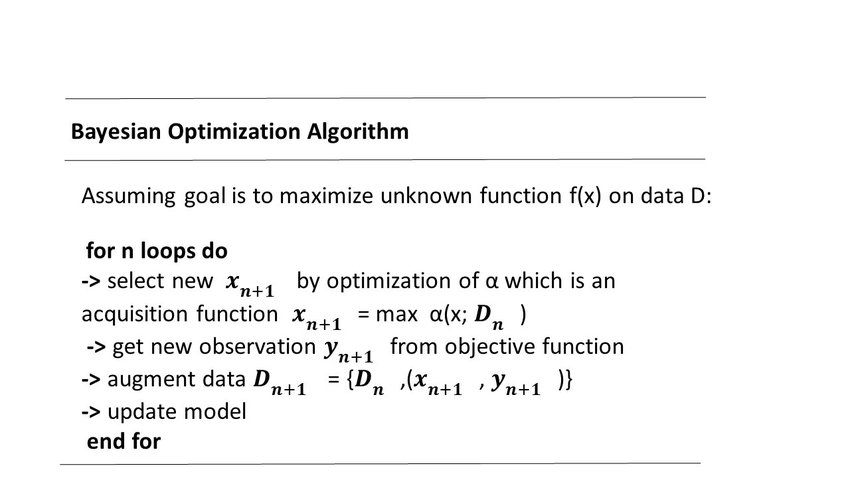

Now that we have covered the necessary components of the Bayesian Optimization algorithm, let's put it all together and run the entire BO routine on the Branin function. The Branin function is a popular optimization benchmark with a complex, multimodal structure, making it an ideal test case for our algorithm. By applying the Bayesian Optimization algorithm to the Branin function, we will demonstrate the effectiveness of the Gaussian Process model and the acquisition functions (UCB, EI, and PI) in guiding the search for the optimal input point. We will compare the performance of the different acquisition functions and discuss the benefits and trade-offs of each method in the context of optimizing the Branin function.

Note that we will use Expected Improvement as our acquisition function, and we will try 2**5 candidate points at each iteration (using Sobol sampling) as possible new query points. We will also use a small value of eps to prioritize exploitation.

In [7]:
# Number of initial points, number of BO steps
n_init = 4
n_steps = 20

# Input space box and initial queries + observations
box = np.array([[-5, 0], [10, 15]])
xinit = sobol_sample(n_init, box)
yinit = branin(xinit[:, 0], xinit[:, 1])

# Instance of Bayesian Optimization. Test on smaller number of points + iters
bo = BayesianOptimizer(
    surrogate=GaussianProcess(), 
    initial_queries=xinit, 
    initial_observations=yinit,
    oracle=branin,
    box=box
)

# Optimization schedule
optx, opty = bo.optimize(num_steps=n_steps, num_points=2**5, acquisition_fn="ei", eps=-8) 

100%|██████████| 20/20 [01:53<00:00,  5.67s/it]


In [8]:
print(f"Min. query point: {optx}")
print(f"Min. observation: {opty}")
print(f"True minimum: {TRUEMIN}")

Min. query point: [-3.00590796 11.78045165]
Min. observation: 0.5153285137473702
True minimum: 0.397887


Let's compare it to the function's global minimums.



In [9]:
fig = plot_function(branin, box[0], box[1], 200, title="me", xlabel="this", ylabel="that")

fig = add_points(
    x=bo.X[:, 0],
    y=bo.X[:, 1],
    z=bo.y,
    num_init=n_init,
    fig=fig
)
fig.show()

After running the full Bayesian Optimization routine on the Branin function using Python, we have demonstrated the power and flexibility of this algorithm in finding the optimal input point. By leveraging the Gaussian Process model and the acquisition functions, the BO algorithm was able to balance exploration and exploitation effectively, navigating through the complex, multimodal landscape of the Branin function to locate the optimal solution.


## 6. Comparing Acquisition Functions

Comparing the performance of the different acquisition functions, we can observe their respective strengths and weaknesses. UCB and PI, which require the tuning of an exploration parameter, may be more sensitive to the choice of this parameter. On the other hand, EI achieves a natural balance between exploration and exploitation without the need for manual parameter tuning. However, it may be more computationally expensive, especially in high-dimensional input spaces.

You can run the routines that generate this plot directly from the `BayesianOptimizer.py` script, by calling it in a command line.

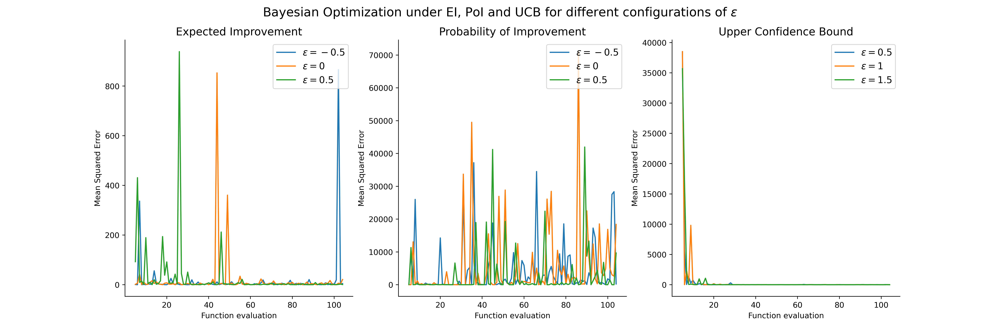

The plot shows more exploration early in the BO schedule on higher values of epsilon. Expected Improvement quickly exploits in the vecinity of the best values found in prior steps, while Probability of Improvement explores more frequently and with much larger average regret results. UCB explores little even on changing parameters of epsilon, and while it tallies a higher regret early on, it quickly starts to exploit around the found minimum.

## 7. Conclusion

In conclusion, the Bayesian Optimization algorithm, with its combination of Gaussian Processes and acquisition functions, is a powerful tool for optimizing complex, expensive-to-evaluate, and possibly noisy functions. Its ability to model uncertainty and balance exploration and exploitation make it particularly suitable for hyperparameter tuning in machine learning, where the evaluation of different configurations can be time-consuming and costly. By carefully selecting the appropriate acquisition function and tuning the necessary parameters, practitioners can achieve excellent optimization performance with the Bayesian Optimization algorithm.